In [1]:
# Load in packages for pandas, astropy, etc. 

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.table import Table
from astropy.io import ascii
from astropy.table import Column, MaskedColumn
from astropy.io.ascii import masked
from astropy import units as u
from astropy.coordinates import SkyCoord
from astropy.cosmology import LambdaCDM 
import matplotlib.patches as patches

#from astroquery.simbad import Simbad
#from astroquery.sdss import SDSS

cosmo = LambdaCDM(H0=70, Om0=0.3, Ode0=0.7) #Creating our choice of cosmology here...

pd.set_option('display.max_columns', 300) # Setting max number of rows per df to be the size of the df
pd.set_option('display.max_rows', None)

In [6]:
#MAC = pd.read_csv('MAC_DR0p5_6Jan2024.csv', sep=',')
MAC = pd.read_csv('MAC_DR0p6_formatted.csv', sep=',')
print(len(MAC))


MACnora = MAC[MAC['RA1']==-99]
MAC = MAC[MAC['RA1']!=-99]

coordconvert = SkyCoord(ra = MAC['RA1'], dec = MAC['Dec1'], frame='icrs', unit = (u.hourangle, u.deg))
MAC['RA1_deg'] = coordconvert.ra.degree
MAC['Dec1_deg'] = coordconvert.dec.degree

print(len(MAC),len(MACnora))


5586


5586 0


In [4]:
m, rb = SOI(172.90494)
print(m,rb)

90431216.01427098 6.805908183495


In [36]:
print(6122*(3.5**2/60**2)) # this is for LET
print(np.sqrt(1642)*(3.5**2/60**2))


20.831805555555555
0.13788599720533135


In [31]:
220-20.831805555555555
135-20.831805555555555


129.4126388888889

In [32]:
print(np.sqrt(220))
print(np.sqrt(135))

14.832396974191326
11.61895003862225


In [38]:
print(220-20.831805555555555,np.sqrt(0.13788599720533135**2+14.832396974191326**2))
print(135-20.831805555555555,np.sqrt(0.13788599720533135**2+11.61895003862225**2))

199.16819444444445 14.833037873214822
114.16819444444445 11.619768179624984


In [37]:
print(1642*(3.5**2/60**2)) # this is for HET
print(np.sqrt(6122)*(3.5**2/60**2))


5.587361111111111
0.2662442581830303


In [39]:
print(np.sqrt(283))
print(np.sqrt(194))

16.822603841260722
13.92838827718412


In [40]:
print(283-5.587361111111111,np.sqrt(0.2662442581830303**2+16.822603841260722**2))
print(194-5.587361111111111,np.sqrt(0.2662442581830303**2+13.92838827718412**2))


277.41263888888886 16.824710577154526
188.4126388888889 13.930932704058815


In [27]:
print(213*(3**2/30**2)) # this is for Chandra
print(np.sqrt(213)*(3**2/30**2))


2.13
0.14594519519326424


In [ ]:
177-2.13
69-2.13


In [34]:
print(np.sqrt(177))
print(np.sqrt(69))

13.30413469565007
8.306623862918075


In [35]:
print(177-2.13,np.sqrt(2.13**2+13.30413469565007**2))
print(69-2.13,np.sqrt(2.13**2+8.306623862918075**2))

174.87 13.473563003155476
66.87 8.575365881407043


In [6]:
np.sqrt(177)

13.30413469565007

In [41]:
175*(30/50)

105.0

In [42]:
np.sqrt(177*(30/50))

10.305338422390601

In [43]:
67*(30/50)

40.199999999999996

In [12]:
np.sqrt(69*(30/50))

6.434283176858165

In [13]:
np.sqrt(220)

14.832396974191326

In [16]:
np.sqrt(283)

16.822603841260722

7.173565017858661
8.845098040014257


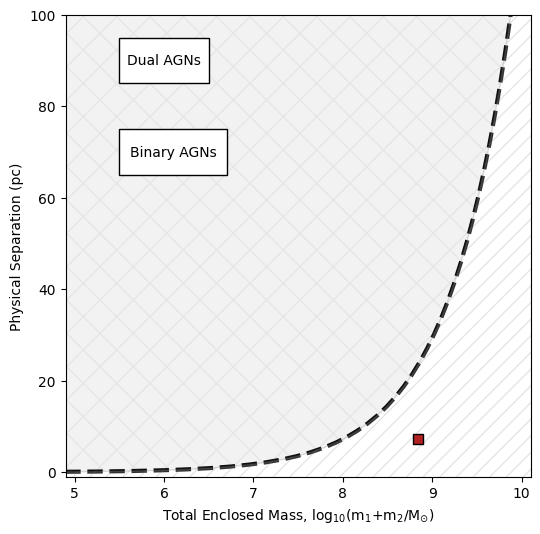

In [3]:
# Here's the m-sigma
def SOI(sigma):
    m = (10**8)*(1.9)*(((sigma)/200)**(5.1))
    rb = (10)*(m/10**8)*((sigma/150)**(-2))
    return m,rb

def SOI2x(sigma):
    m = (10**8)*(1.9)*(((sigma)/200)**(5.1))*2
    rb = (10)*(m/10**8)*((sigma/150)**(-2))
    return m,rb

sigma = [30,40,50,60,70,80,90,100,110,120,130,140,150,160,170,\
         180,190,200,210,220,230,240,250,260,270,280,290,\
         300,310,320,330,340,350,360,370,380,390,400,410,420,430,440,450,460,470]

R = []
M = []
Rx2 = []
Mx2 = []
for sig in sigma:
    m, rb = SOI(sig)
    R.append(rb)
    M.append(m)

for sig in sigma:
    m, rb = SOI(sig)
    Rx2.append(rb)
    Mx2.append(m)
    
fig, ax = plt.subplots(figsize=(6,6))

print(np.log10((7.457+7.456)*1.e+6))
print(np.log10(7.0e+8))

ax.plot(np.log10(M), R, c='black', linestyle='dashed', linewidth=3)
ax.scatter(np.log10(7.0e+8), 7.3, c='firebrick', marker='s', s=60, zorder=100, edgecolor='black')

# Determine the y-limits for shading
ymin, ymax = ax.get_ylim()

# Shade above and below the curve
ax.fill_between(np.log10(M), R, 200, where=(R <= ymax), interpolate=True, color='grey', edgecolor='grey', hatch='\\/', alpha=0.1, zorder=2)
ax.fill_between(np.log10(M), R, -5, where=(R >= ymin), interpolate=True, color='white',edgecolor='grey', hatch='//', zorder=2, alpha=0.2)

ax.set_xlim(4.9, 10.1)
ax.set_ylim(-1, 100)

rect1 = patches.Rectangle((5.5, 85), 1, 10, edgecolor='black', facecolor='white', zorder=4)
ax.add_patch(rect1)
ax.text(6, 90, 'Dual AGNs', ha='center', va='center', zorder=5)

# Create a rectangle for the second text box
rect2 = patches.Rectangle((5.5, 65), 1.2, 10, edgecolor='black', facecolor='white', zorder=4)
ax.add_patch(rect2)
ax.text(6.1, 70, 'Binary AGNs', ha='center', va='center', zorder=5)


plt.ylabel('Physical Separation (pc)')
plt.xlabel('Total Enclosed Mass, log$_{10}$(m$_{1}$+m$_{2}$/M$_{\odot}$)')
plt.show()


7.173565017858661
8.845098040014257


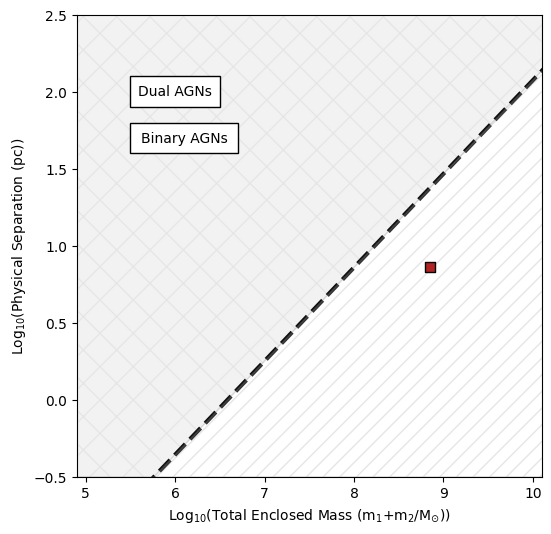

In [3]:
print(np.log10((7.457+7.456)*1.e+6))
print(np.log10(7.0e+8))

# Convert R to log10 values
logR = np.log10(R)

fig, ax = plt.subplots(figsize=(6,6))

ax.plot(np.log10(M), logR, c='black', linestyle='dashed', linewidth=3)
#ax.plot(np.log10(2*M), logR, c='black', linestyle='dotted', linewidth=3)
#ax.plot(np.log10(M), logR, c='black', linestyle='dotted', linewidth=3)
ax.scatter(np.log10(7.0e+8), np.log10(7.3), c='firebrick', marker='s', s=60, zorder=100, edgecolor='black')

# Determine the y-limits for shading
ymin, ymax = ax.get_ylim()

# Shade above and below the curve
ax.fill_between(np.log10(M), logR, 2.5, where=(logR <= ymax), interpolate=True, color='grey', edgecolor='grey', hatch='\\/', alpha=0.1, zorder=2)
ax.fill_between(np.log10(M), logR, -0.5, where=(logR >= ymin), interpolate=True, color='white', edgecolor='grey', hatch='//', zorder=2, alpha=0.2)

ax.set_xlim(4.9, 10.1)
ax.set_ylim(-0.5, 2.5)

rect1 = patches.Rectangle((5.5, 1.9), 1, 0.2, edgecolor='black', facecolor='white', zorder=4)
ax.add_patch(rect1)
ax.text(6, 2, 'Dual AGNs', ha='center', va='center', zorder=5)

rect2 = patches.Rectangle((5.5, 1.6), 1.2, 0.2, edgecolor='black', facecolor='white', zorder=4)
ax.add_patch(rect2)
ax.text(6.1, 1.7, 'Binary AGNs', ha='center', va='center', zorder=5)

plt.ylabel('Log$_{10}$(Physical Separation (pc))')
plt.xlabel('Log$_{10}$(Total Enclosed Mass (m$_{1}$+m$_{2}$/M$_{\odot}$))')
plt.show()

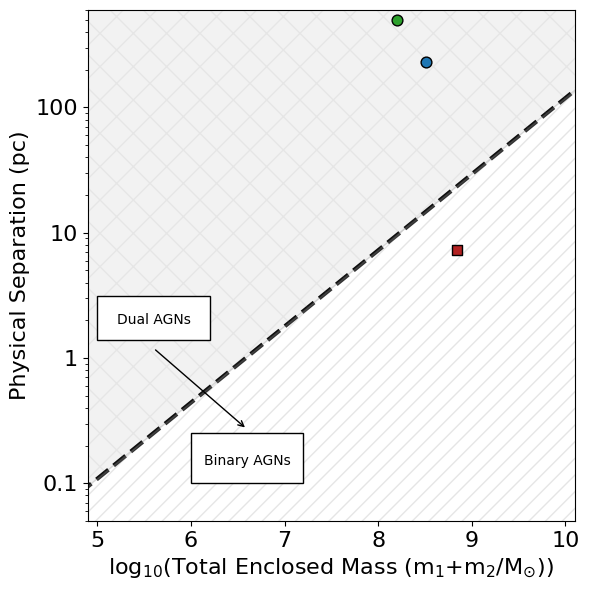

In [7]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as patches

# ... [rest of your code to generate M and R]

fig, ax = plt.subplots(figsize=(6,6))

ax.plot(np.log10(M), R, c='black', linestyle='dashed', linewidth=3)
#ax.plot(np.log10(Mx2), Rx2, c='black', linestyle='dotted', linewidth=3)

ax.scatter(np.log10(7.0e+8), 7.3, c='firebrick', marker='s', s=60, zorder=100, edgecolor='black')
ax.scatter(np.log10((10**8.1) +(10**8.3)), 230, c='tab:blue', s=60, zorder=100, edgecolor='black')
ax.scatter(np.log10(((1.54e+8)+(6.3e+6))), 500, c='tab:green', s=60, zorder=100, edgecolor='black')
# Setting the y-axis to log scale
ax.set_yscale('log')

# Shade above and below the curve
ymin, ymax = ax.get_ylim()
ax.fill_between(np.log10(M), R, 600, where=(np.array(R) <= 600), interpolate=True, color='grey', edgecolor='grey', hatch='\\/', alpha=0.1, zorder=2)
ax.fill_between(np.log10(M), R, ymin, where=(np.array(R) >= ymin), interpolate=True, color='white', edgecolor='grey', hatch='//', zorder=2, alpha=0.2)

ax.set_xlim(4.9, 10.1)
ax.set_ylim(0.05,600)

# Set y-tick labels to display original values
ticks = [0.1, 1, 10, 100]
ax.set_yticks(ticks)
ax.set_yticklabels([str(val) for val in ticks])

rect1 = patches.Rectangle((5., 1.4), 1.2, 1.7, edgecolor='black', facecolor='white', zorder=4)
ax.add_patch(rect1)
ax.text(5.6, 2, 'Dual AGNs', ha='center', va='center', zorder=5)

rect2 = patches.Rectangle((6, 0.1), 1.2, 0.15, edgecolor='black', facecolor='white', zorder=4)
ax.add_patch(rect2)
ax.text(6.6, 0.15, 'Binary AGNs', ha='center', va='center', zorder=5)

ax.annotate('', xy=(6.6, 0.27), xytext=(5.6, 1.2),
             arrowprops=dict(facecolor='black', arrowstyle='->'),
             zorder=6)

ax.tick_params(axis='both', which='major', labelsize=16)

plt.ylabel('Physical Separation (pc)', fontsize=16)
plt.xlabel('log$_{10}$(Total Enclosed Mass (m$_{1}$+m$_{2}$/M$_{\odot}$))', fontsize=16)

plt.tight_layout()
plt.savefig('dual_v_binary.pdf', dpi=150)
plt.show()

In [6]:
5007*(1+1)

10014

In [118]:
types = [(MAC['Confidence Flag']==1).sum(), \
         (MAC['Confidence Flag']==0.5).sum(),(MAC['Confidence Flag']==0).sum(), \
         (MAC['Confidence Flag']==-0.5).sum(),(MAC['Confidence Flag']==-1).sum(),5]



classes = ['Confirmed', 'Possible', 'Candidate', 'Insufficient Evidence', 'Unlikely']



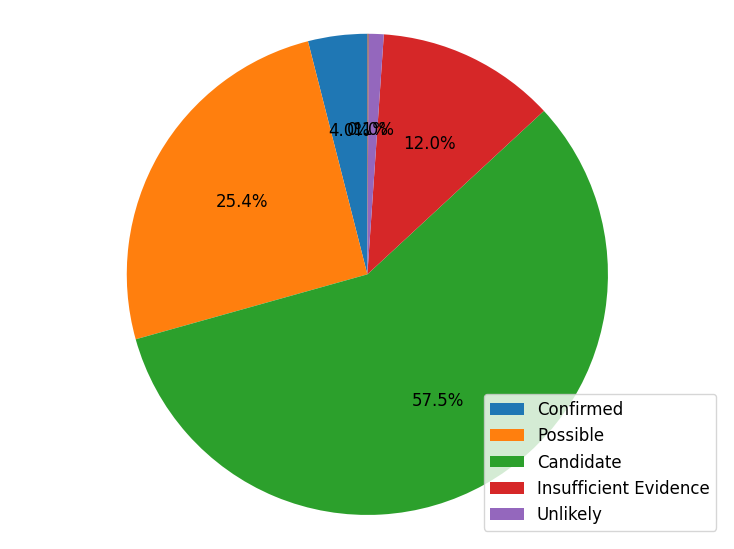

In [120]:

#explode = (0, 0.1, 0, 0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig, ax = plt.subplots(figsize=(8,6))
plt.rcParams.update({'font.size': 12})
plt.tight_layout()

ax.pie(types, labels=None, autopct='%1.1f%%', startangle=90)
#shadow=True,,
ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.legend(loc="lower right", labels=classes)

plt.savefig('confdistr_dr0p6.pdf', dpi=150)


plt.show()

In [10]:
#x = (MAC['Processed System Type']=='Binary AGN Candidate').sum() + (MAC['Processed System Type']=='Dual AGN Candidate / Recoil Candidate / Binary SMBH Candidate').sum() + (MAC['Processed System Type']=='Dual AGN / Quasar Candidate').sum() + (MAC['Processed System Type']=='Dual AGN / Binary Quasar').sum() + (MAC['Processed System Type']=='Recoil Candidate / Binary SMBH Candidate').sum() + (MAC['Processed System Type']=='Recoil Candidate / Double-Peaked Emitter').sum() + (MAC['Processed System Type']=='Recoil Candidate / Binary Quasar Candidate').sum()


#types = [((MAC['Processed System Type']=='Dual AGN Candidate').sum()+(MAC['Processed System Type']=='Dual AGN').sum()), \
#         (MAC['Processed System Type']=='Binary Quasar / Lens').sum(), \
#         ((MAC['Processed System Type']=='Binary Quasar').sum()+(MAC['Processed System Type']=='Binary Quasar Candidate').sum()), \
#         ((MAC['Processed System Type']=='Binary SMBH Candidate').sum()+(MAC['Processed System Type']=='Binary SMBH').sum()), \
#         (MAC['Processed System Type']=='Recoil Candidate').sum(),6]

types = [((MAC['Processed System Type']=='Dual AGN Candidate').sum()+(MAC['Processed System Type']=='Dual AGN').sum()), \
         (MAC['Processed System Type']=='Dual AGN Candidate / Recoil Candidate').sum(), \
         ((MAC['Processed System Type']=='Binary SMBH Candidate').sum()+(MAC['Processed System Type']=='Binary SMBH').sum()), \
         (MAC['Processed System Type']=='Recoil Candidate').sum(),\
         (MAC['Processed System Type']=='Binary AGN Candidate / Dual AGN Candidate').sum(),\
         (MAC['Processed System Type']=='Binary AGN Candidate / Dual AGN Candidate / Recoil Candidate').sum(),\
         (MAC['Processed System Type']=='Binary AGN Candidate / Binary SMBH Candidate / Dual AGN Candidate').sum(),\
         (MAC['Processed System Type']=='Binary SMBH Candidate / Dual AGN Candidate').sum(),
         (MAC['Processed System Type']=='Binary AGN Candidate / Dual AGN').sum(),9]

#classes = ['Dual AGNs + Candidates', 'Binary Quasars / Lenses', 'Binary Quasars + Candidates', 'Binary SMBHs + Candidates', \
#           'Recoil Candidates', 'Other']

classes = ['Dual AGN Candidate', 'Dual AGN', 'Dual AGN Candidate / Recoil Candidate',\
           'Binary AGN Candidate / Dual AGN Candidate',\
           'Binary AGN Candidate / Dual AGN Candidate / Recoil Candidate',\
           'Binary AGN Candidate / Binary SMBH Candidate / Dual AGN Candidate',\
           'Binary SMBH Candidate / Dual AGN Candidate',\
           'Binary AGN Candidate / Dual AGN']

#'Dual AGN Candidate' 'Dual AGN' 'Dual AGN Candidate / Recoil Candidate'
# 'Binary AGN Candidate / Dual AGN Candidate'
# 'Binary AGN Candidate / Dual AGN Candidate / Recoil Candidate'
# 'Binary AGN Candidate / Binary SMBH Candidate / Dual AGN Candidate'
# 'Binary SMBH Candidate / Dual AGN Candidate'
# 'Binary AGN Candidate / Dual AGN'

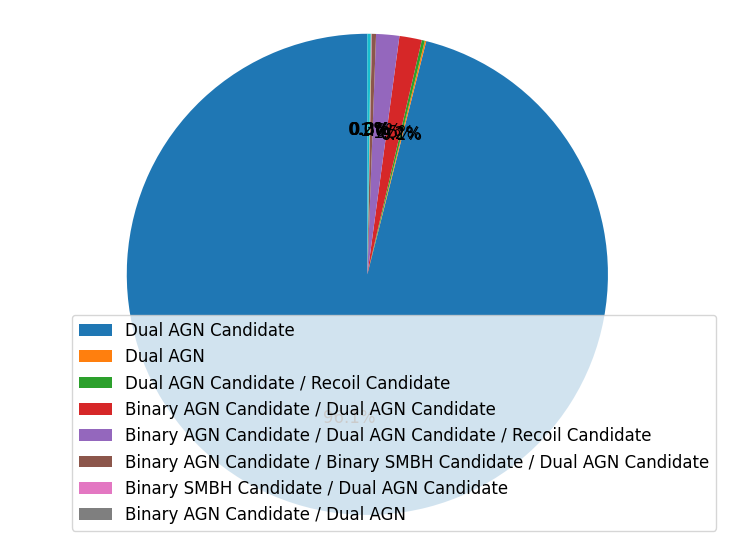

In [11]:

#explode = (0, 0.1, 0, 0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig, ax = plt.subplots(figsize=(8,6))
plt.rcParams.update({'font.size': 12})
plt.tight_layout()

ax.pie(types, labels=None, autopct='%1.1f%%', startangle=90)
#shadow=True,
#explode=explode,
ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.legend(loc="lower right", labels=classes)

#plt.savefig('classdistr_dr0p1.pdf', dpi=150)


plt.show()

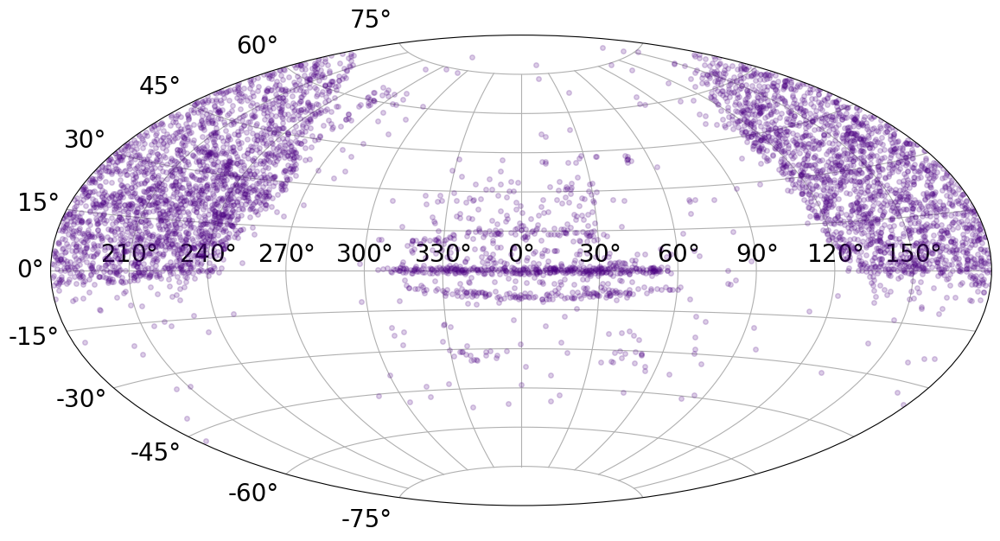

In [99]:
# Now converting the coordinates so that we can map them onto an Aitoff projection map

coords1 = SkyCoord(ra=MAC['RA1_deg'], dec=MAC['Dec1_deg'], frame='icrs', unit='deg') #Making a SkyCoord object from the degree coordinates

#coords2 = SkyCoord(ra=MAC['RA2_deg'], dec=MAC['Dec2_deg'], frame='icrs', unit='deg') #Making a SkyCoord object from the degree coordinates


# Now converting to radians, which is required by Matplotlib. Also required that the coordinates fall between \
# -pi and +pi , not 0 and 2pi, so also taking that into account here...
coords_ra_rad1 = coords1.ra.wrap_at(180 * u.deg).radian 
coords_dec_rad1 = coords1.dec.radian

#coords_ra_rad2 = coords2.ra.wrap_at(180 * u.deg).radian 
#coords_dec_rad2 = coords2.dec.radian

import matplotlib.pyplot as plt

fig = plt.figure(figsize=(12,8))
plt.rcParams.update({'font.size': 20})
#plt.figure(figsize=(12,8))
ax = fig.add_subplot(111, projection="aitoff")
#plt.title("Sky Distribution of WMAGN")
ax.grid(True)
ax.plot(coords_ra_rad1, coords_dec_rad1, 'o', markersize=4, alpha=0.2, c='indigo')
#plt.plot(coords_ra_rad2, coords_dec_rad2, 'o', markersize=4, alpha=0.3, c='royalblue')
#plt.plot(coords_ra_rad3, coords_dec_rad3, 'o', markersize=4, alpha=0.3, c='royalblue')

#plt.plot(wang_ra_rad, wang_dec_rad, '^', markersize=4, alpha=0.3, c='firebrick', label='Wang+2009')
#plt.plot(myers_ra_rad, myers_dec_rad, 's', markersize=4, alpha=0.3, c='forestgreen', label='Myers+2007')
#plt.plot(kirkman_ra_rad, kirkman_dec_rad, 'v', markersize=4, alpha=0.3, c='blueviolet', label='Kirkman+2008')
#plt.plot(tytler_ra_rad, tytler_dec_rad, 'D', markersize=4, alpha=0.3, c='darkorange', label='Tytler+2009')
#plt.plot(kyber_ra_rad, kyber_dec_rad, '*', markersize=4, alpha=0.3, c='black' , label='Individual Targets')
#plt.legend(loc='lower right')
ax.set_xticklabels(['$210\degree$','$240\degree$','$270\degree$','$300\degree$','$330\degree$','$0\degree$',\
                    '$30\degree$','$60\degree$','$90\degree$','$120\degree$','$150\degree$'])
plt.subplots_adjust(top=0.95,bottom=0.0)
plt.tight_layout()
plt.savefig('Skydistribution_BigMAC_DR1.pdf', dpi=150)
plt.show()



In [ ]:
from matplotlib.ticker import PercentFormatter

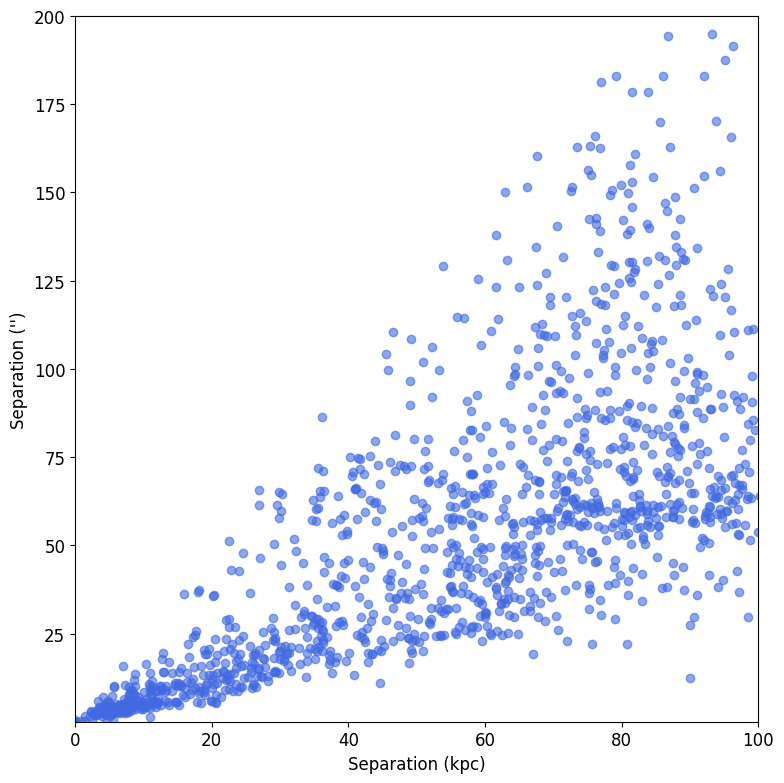

In [12]:
#Here I'm plotting the WISE colors and adding the Jarrett box and the Stern cut
#Constructing a grid of subplots showing the WISE color space

fig, ax = plt.subplots(figsize = (8,8))
ax.set_xlim([-0.01, 100])
ax.set_ylim([0.01, 200])

im1 = ax.scatter(x=MAC['Sep(kpc)'], y=MAC['Sep'], c='royalblue', alpha=0.6)
#ax.set_yscale("log")
#ax.set_xscale("log")
#im2 = ax.scatter(x=MAC['rp'], y=MAC['sep'], c='royalblue', alpha=0.6) 
#ax1.plot(x, y,'--', linewidth = 2, color = 'k')
#ax1.vlines(x = 2.2, ymin = 2.2*0.1+0.38, ymax = 1.7, linestyle = '--', alpha = 1, linewidth = 2)
#ax1.vlines(x = 4.2, ymin = 4.2*0.1+0.38, ymax = 1.7, linestyle = '--', alpha = 1, linewidth = 2)
#ax1.hlines(y = 1.7, xmin = 2.2, xmax = 4.2, linestyle='--', alpha=1, linewidth = 2)

#plotting the Stern 2012 cut
#ax1.hlines(y = 0.8, xmin = 1, xmax = 5, linestyle = '-.', alpha = 1, linewidth = 2)

ax.set(xlabel="Separation (kpc)", ylabel="Separation ('')")

#cbar = fig.colorbar(im1,ax=ax)
#cbar.ax.set_ylabel('log($L_{2-10\,\mathrm{keV,\,Obs.}}\,/\,\mathrm{erg\,s}^{-1}$)')

plt.tight_layout()
#plt.savefig('WMAGN_arcsec_v_kpc.pdf', dpi=150)

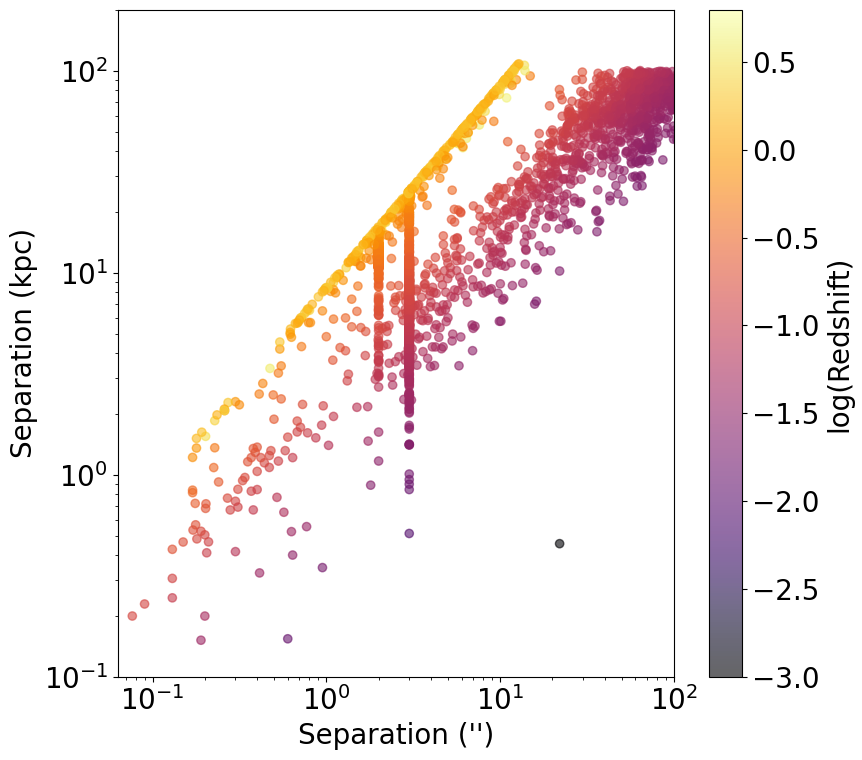

In [101]:
#Here I'm plotting the WISE colors and adding the Jarrett box and the Stern cut
#Constructing a grid of subplots showing the WISE color space

fig, ax = plt.subplots(figsize = (9,8))
ax.set_xlim([10**-1.2, 10**2])
ax.set_ylim([10**-1, 2*10**2])

MACz1 = MAC[MAC['z1']>0]

#im1 = ax.scatter(x=MAC['Sep(kpc)'], y=MAC['Sep'], c=MAC['z1'], cmap='inferno', alpha=0.6)
im2 = ax.scatter(x=MACz1['Sep'], y=MACz1['Sep(kpc)_z1'], c=np.log10(MACz1['z1']), cmap='inferno', alpha=0.6) 

ax.set(xlabel="Separation ('')", ylabel="Separation (kpc)")
ax.set_yscale("log")
ax.set_xscale("log")

cbar = fig.colorbar(im2,ax=ax)
cbar.ax.set_ylabel('log(Redshift)')

plt.tight_layout()
plt.savefig('MAC_arcsec_kpc_zaux.pdf', dpi=150)

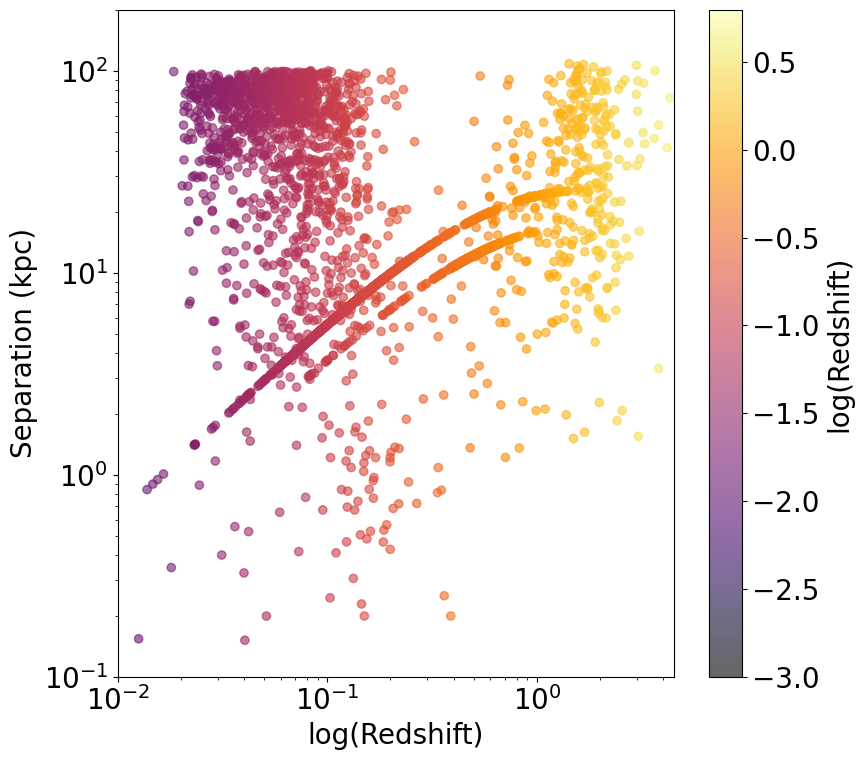

In [102]:
#Here I'm plotting the WISE colors and adding the Jarrett box and the Stern cut
#Constructing a grid of subplots showing the WISE color space

fig, ax = plt.subplots(figsize = (9,8))
ax.set_xlim([10**-2, 4.5*10**0])
ax.set_ylim([10**-1, 2*10**2])

MACz1 = MAC[MAC['z1']>0]

#im1 = ax.scatter(x=MAC['Sep(kpc)'], y=MAC['Sep'], c=MAC['z1'], cmap='inferno', alpha=0.6)
im2 = ax.scatter(x=MACz1['z1'], y=MACz1['Sep(kpc)_z1'], c=np.log10(MACz1['z1']), cmap='inferno', alpha=0.6) 

ax.set(xlabel="log(Redshift)", ylabel="Separation (kpc)")
ax.set_yscale("log")
ax.set_xscale("log")

cbar = fig.colorbar(im2,ax=ax)
cbar.ax.set_ylabel('log(Redshift)')

plt.tight_layout()
plt.savefig('MAC_z_kpc_zaux.pdf', dpi=150)

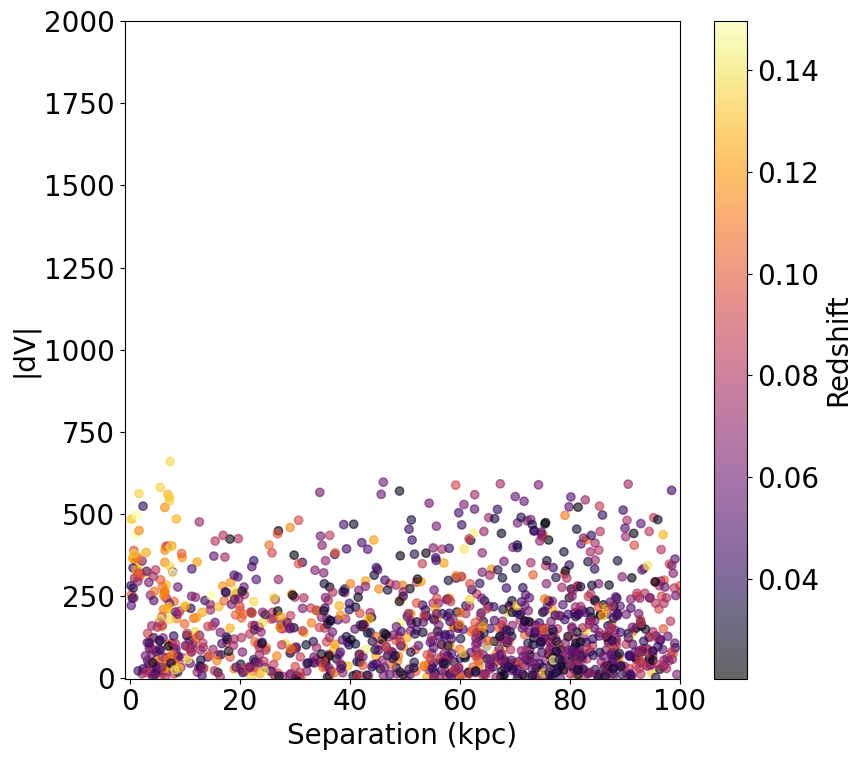

In [32]:
#Here I'm plotting the WISE colors and adding the Jarrett box and the Stern cut
#Constructing a grid of subplots showing the WISE color space

fig, ax = plt.subplots(figsize = (9,8))
ax.set_xlim([-1, 100])
ax.set_ylim([-1, 2000])

MACz1z2 = MAC[(MAC['z1']<0.15) & (MAC['z2']<0.15) & (MAC['dV']!=-99)]

#im1 = ax.scatter(x=MAC['Sep(kpc)'], y=MAC['Sep'], c=MAC['z1'], cmap='inferno', alpha=0.6)
im2 = ax.scatter(x=MACz1z2['Sep(kpc)_z1'], y=np.absolute(MACz1z2['dV']), c=MACz1z2['z1'], cmap='inferno', alpha=0.6) 

ax.set(xlabel="Separation (kpc)", ylabel="|dV|")

cbar = fig.colorbar(im2,ax=ax)
cbar.ax.set_ylabel('Redshift')

plt.tight_layout()
plt.savefig('MAC_kpc_dV_zaux_zless0p15.pdf', dpi=150)

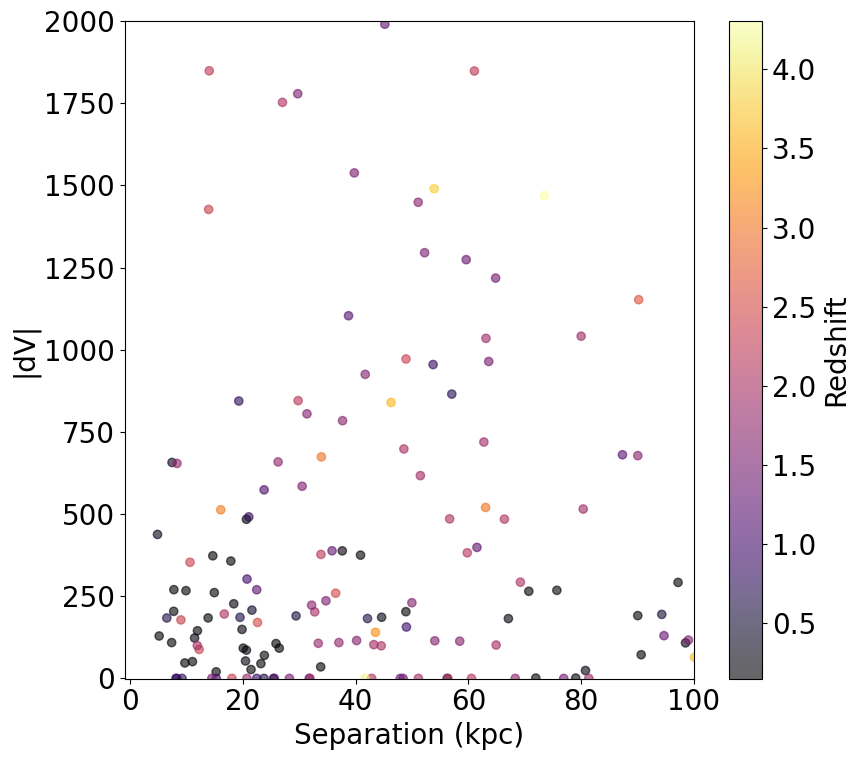

In [31]:
#Here I'm plotting the WISE colors and adding the Jarrett box and the Stern cut
#Constructing a grid of subplots showing the WISE color space

fig, ax = plt.subplots(figsize = (9,8))
ax.set_xlim([-1, 100])
ax.set_ylim([-1, 2000])

MACz1z2 = MAC[(MAC['z1']>0.15) & (MAC['z2']>0.15) & (MAC['dV']!=-99)]

#im1 = ax.scatter(x=MAC['Sep(kpc)'], y=MAC['Sep'], c=MAC['z1'], cmap='inferno', alpha=0.6)
im2 = ax.scatter(x=MACz1z2['Sep(kpc)_z1'], y=np.absolute(MACz1z2['dV']), c=MACz1z2['z1'], cmap='inferno', alpha=0.6) 

ax.set(xlabel="Separation (kpc)", ylabel="|dV|")

cbar = fig.colorbar(im2,ax=ax)
cbar.ax.set_ylabel('Redshift')

plt.tight_layout()
plt.savefig('MAC_kpc_dV_zaux_zgtr0p15.pdf', dpi=150)

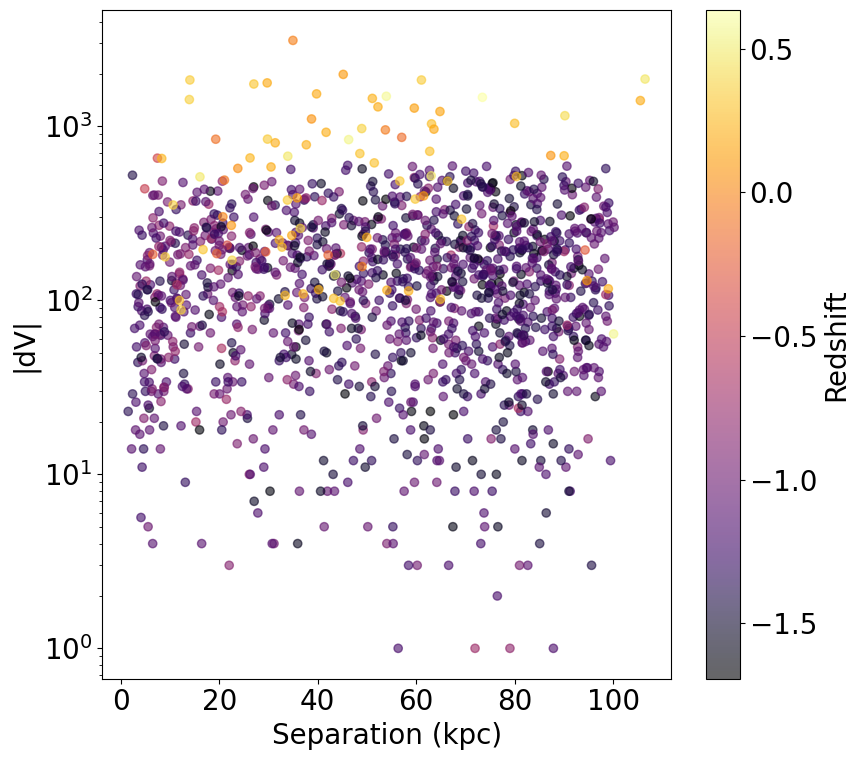

In [110]:
#Here I'm plotting the WISE colors and adding the Jarrett box and the Stern cut
#Constructing a grid of subplots showing the WISE color space

fig, ax = plt.subplots(figsize = (9,8))
#ax.set_xlim([-1, 100])
#ax.set_ylim([-1, 2000])

MACz1z2 = MAC[(MAC['z1']>0) & (MAC['z2']>0) & (MAC['dV']!=-99)]

#im1 = ax.scatter(x=MAC['Sep(kpc)'], y=MAC['Sep'], c=MAC['z1'], cmap='inferno', alpha=0.6)
im2 = ax.scatter(x=MACz1z2['Sep(kpc)_z1'], y=np.absolute(MACz1z2['dV']), c=np.log10(MACz1z2['z1']), cmap='inferno', alpha=0.6) 

ax.set(xlabel="Separation (kpc)", ylabel="|dV|")

cbar = fig.colorbar(im2,ax=ax)
cbar.ax.set_ylabel('Redshift')

ax.set_yscale("log")
#ax.set_xscale("log")

plt.tight_layout()
plt.savefig('MAC_kpc_dV_zaux.pdf', dpi=150)

In [25]:
MACz1z2

,Unnamed: 0,System Type,Literature Name,Selection Method,Confirmation Method,Name1,z1,z1_type,RA1,Dec1,Coordinate_waveband1,Coordinate_Source1,Equinox1,Brightness1,Brightness_band1,Brightness_type1,Name2,z2,z2_type,RA2,Dec2,Equinox2,Coordinate_waveband2,Coordinate_Source2,Brightness2,Brightness_band2,Brightness_type2,dV,Sep,Sep(kpc),dV_rwp,Paper(s),BibCode(s),DOI(s),Notes,Confidence Flag,Legacy System Type,Processed System Type,dV_new,Sep(kpc)_z1,Sep(kpc)_z2,Processed Selection Method,RA1_deg,Dec1_deg
0,0,Dual AGN Candidate / Likely Single AGN,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000249.07+004504.8,0.086800,spec,00:02:49.07,+00:45:04.8,Optical,SDSS,J2000,-99.0,-99,-99,J000249.44+004506.7,0.086500,spec,00:02:49.44,+00:45:06.7,J2000,Optical,SDSS,-99.0,-99,-99,63.000000,5.865765,9.534117,82.547277,Liu+2011b ; Wang+2009 ; Liu+2010a ; Tingay+201...,2011ApJ...737..101L ; 2009ApJ...705L..76W ; 20...,https://doi.org/10.1088/0004-637X/737/2/101 ; ...,. Tingay+ find no evidence of double radio c...,0.5,Dual AGN Candidate / Likely Single AGN,Dual AGN Candidate / Likely Single AGN,82.547277,9.534117,9.504464,NaN,0.704458,0.751333
1,1,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000257.21+000750.5,0.090100,spec,00:02:57.21,+00:07:50.5,Optical,SDSS,J2000,-99.0,-99,-99,J000258.59+000831.0,0.089700,spec,00:02:58.59,+00:08:31.0,J2000,Optical,SDSS,-99.0,-99,-99,109.000000,45.483377,76.446410,109.734834,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,109.734834,76.446410,76.142188,NaN,0.738375,0.130694
2,2,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000323.74+010547.3,0.099300,spec,00:03:23.74,+01:05:47.3,Optical,SDSS,J2000,-99.0,-99,-99,J000323.74+010559.5,0.099400,spec,00:03:23.74,+01:05:59.5,J2000,Optical,SDSS,-99.0,-99,-99,22.000000,12.200000,22.360857,-27.197890,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,-27.197890,22.360857,22.380806,NaN,0.848917,1.096472
3,3,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000425.78-095854.4,0.112200,spec,00:04:25.78,-09:58:54.4,Optical,SDSS,J2000,-99.0,-99,-99,J000426.66-095834.4,0.112000,spec,00:04:26.66,-09:58:34.4,J2000,Optical,SDSS,-99.0,-99,-99,53.000000,23.853885,48.677088,53.772142,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,53.772142,48.677088,48.601392,NaN,1.107417,-9.981778
4,4,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000431.92-011411.7,0.088700,spec,00:04:31.92,-01:14:11.7,Optical,SDSS,J2000,-99.0,-99,-99,J000433.25-011334.4,0.088900,spec,00:04:33.25,-01:13:34.4,J2000,Optical,SDSS,-99.0,-99,-99,45.000000,42.297857,70.100953,-54.922850,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,-54.922850,70.100953,70.242780,NaN,1.133000,-1.236583
5,5,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000621.33-100412.6,0.106200,spec,00:06:21.33,-10:04:12.6,Optical,SDSS,J2000,-99.0,-99,-99,J000623.74-100345.0,0.105600,spec,00:06:23.74,-10:03:45.0,J2000,Optical,SDSS,-99.0,-99,-99,165.000000,45.040625,87.594159,162.220804,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,162.220804,87.594159,87.159054,NaN,1.588875,-10.070167
6,6,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000700.56+005410.5,0.092500,spec,00:07:00.56,+00:54:10.5,Optical,SDSS,J2000,-99.0,-99,-99,J000704.18+005425.0,0.093500,spec,00:07:04.18,+00:54:25.0,J2000,Optical,SDSS,-99.0,-99,-99,250.000000,56.196126,96.699700,-273.558955,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,-273.558955,96.699700,97.632510,NaN,1.752333,

In [17]:
MACz1

,Unnamed: 0,System Type,Literature Name,Selection Method,Confirmation Method,Name1,z1,z1_type,RA1,Dec1,Coordinate_waveband1,Coordinate_Source1,Equinox1,Brightness1,Brightness_band1,Brightness_type1,Name2,z2,z2_type,RA2,Dec2,Equinox2,Coordinate_waveband2,Coordinate_Source2,Brightness2,Brightness_band2,Brightness_type2,dV,Sep,Sep(kpc),dV_rwp,Paper(s),BibCode(s),DOI(s),Notes,Confidence Flag,Legacy System Type,Processed System Type,dV_new,Sep(kpc)_z1,Sep(kpc)_z2,Processed Selection Method,RA1_deg,Dec1_deg
0,0,Dual AGN Candidate / Likely Single AGN,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000249.07+004504.8,0.086800,spec,00:02:49.07,+00:45:04.8,Optical,SDSS,J2000,-99.0,-99,-99,J000249.44+004506.7,0.086500,spec,00:02:49.44,+00:45:06.7,J2000,Optical,SDSS,-99.0,-99,-99,63.000000,5.865765e+00,9.534117,82.547277,Liu+2011b ; Wang+2009 ; Liu+2010a ; Tingay+201...,2011ApJ...737..101L ; 2009ApJ...705L..76W ; 20...,https://doi.org/10.1088/0004-637X/737/2/101 ; ...,. Tingay+ find no evidence of double radio c...,0.5,Dual AGN Candidate / Likely Single AGN,Dual AGN Candidate / Likely Single AGN,82.547277,9.534117,9.504464,NaN,0.704458,0.751333
1,1,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000257.21+000750.5,0.090100,spec,00:02:57.21,+00:07:50.5,Optical,SDSS,J2000,-99.0,-99,-99,J000258.59+000831.0,0.089700,spec,00:02:58.59,+00:08:31.0,J2000,Optical,SDSS,-99.0,-99,-99,109.000000,4.548338e+01,76.446410,109.734834,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,109.734834,76.446410,76.142188,NaN,0.738375,0.130694
2,2,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000323.74+010547.3,0.099300,spec,00:03:23.74,+01:05:47.3,Optical,SDSS,J2000,-99.0,-99,-99,J000323.74+010559.5,0.099400,spec,00:03:23.74,+01:05:59.5,J2000,Optical,SDSS,-99.0,-99,-99,22.000000,1.220000e+01,22.360857,-27.197890,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,-27.197890,22.360857,22.380806,NaN,0.848917,1.096472
3,3,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000425.78-095854.4,0.112200,spec,00:04:25.78,-09:58:54.4,Optical,SDSS,J2000,-99.0,-99,-99,J000426.66-095834.4,0.112000,spec,00:04:26.66,-09:58:34.4,J2000,Optical,SDSS,-99.0,-99,-99,53.000000,2.385389e+01,48.677088,53.772142,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,53.772142,48.677088,48.601392,NaN,1.107417,-9.981778
4,4,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000431.92-011411.7,0.088700,spec,00:04:31.92,-01:14:11.7,Optical,SDSS,J2000,-99.0,-99,-99,J000433.25-011334.4,0.088900,spec,00:04:33.25,-01:13:34.4,J2000,Optical,SDSS,-99.0,-99,-99,45.000000,4.229786e+01,70.100953,-54.922850,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,-54.922850,70.100953,70.242780,NaN,1.133000,-1.236583
5,5,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000621.33-100412.6,0.106200,spec,00:06:21.33,-10:04:12.6,Optical,SDSS,J2000,-99.0,-99,-99,J000623.74-100345.0,0.105600,spec,00:06:23.74,-10:03:45.0,J2000,Optical,SDSS,-99.0,-99,-99,165.000000,4.504062e+01,87.594159,162.220804,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,162.220804,87.594159,87.159054,NaN,1.588875,-10.070167
6,6,Dual AGN Candidate,-99,Fiber Spectra / Optical Spectroscopic Emission...,-99,J000700.56+005410.5,0.092500,spec,00:07:00.56,+00:54:10.5,Optical,SDSS,J2000,-99.0,-99,-99,J000704.18+005425.0,0.093500,spec,00:07:04.18,+00:54:25.0,J2000,Optical,SDSS,-99.0,-99,-99,250.000000,5.619613e+01,96.699700,-273.558955,Liu+2011b,2011ApJ...737..101L,https://doi.org/10.1088/0004-637X/737/2/101,,0.5,Dual AGN Candidate,Dual AGN Candidate,-273.558955,96.699700,9

In [1]:
# import matplotlib.pyplot as plt
# from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# # Sample data
# #MAC = {'Sep(kpc)': [some_data], 'Sep': [some_data], 'z1': [some_data]}

# fig, ax = plt.subplots(figsize=(8,8))
# ax.set_xlim([-1, 100])
# ax.set_ylim([-1, 200])
# plt.rcParams.update({'font.size': 20})

# im1 = ax.scatter(x=MAC['Sep(kpc)'], y=MAC['Sep'], c=MAC['z1'], alpha=0.9, marker='o', s=60, \
#                  facecolors='none', cmap='inferno',linewidths=2, vmax=0.2)

# axins = inset_axes(ax,
#                    width="5%",  # width = 5% of parent_bbox width
#                    height="80%",  # height : 50%
#                    loc='upper left',
#                    bbox_to_anchor=(0.025, 0., 1, 0.98),
#                    bbox_transform=ax.transAxes,
#                    borderpad=0,
#                    )

# ax.set(xlabel="Separation (kpc)", ylabel="Separation ('')")

# ax.hlines(2.5,-0.01,100, linestyle='dashed', linewidth=4, color='tab:blue')

# ax.text(78, 8, 'VLASS Resolution', ha='center', va='center', zorder=5)
# ax.hlines(2.5,-0.01,100, linestyle='dashed', linewidth=4, color='tab:blue')

# ax.text(75.5, 36, '$eROSITA$ Resolution', ha='center', va='center', zorder=5)
# ax.hlines(30,-0.01,100, linestyle='dotted', linewidth=4, color='tab:green')

# # Use im1 to create the colorbar
# cbar = fig.colorbar(im1, cax=axins, orientation="vertical", ticks=[0.05, 0.1, 0.15, 0.2])
# cbar.ax.set_ylabel('Redshift')
# axins.xaxis.set_ticks_position("bottom")

# plt.tight_layout()
# #plt.savefig('BigMAC_arcsec_v_kpc_aux.pdf', dpi=300)
# plt.show()



